In [2]:
!pip3 install tqdm -q

In [3]:
import torch
import torch.nn as nn
import torch.optim as optim
import os
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm

In [4]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [5]:
path = "yosemite"

In [6]:
class CycleGANDataset(Dataset):
    def __init__(self, root, transform=None):
        self.transform = transform

        self.dir_A = os.path.join(root, 'trainA')
        self.dir_B = os.path.join(root, 'trainB')

        self.files_A = sorted(os.listdir(self.dir_A))
        self.files_B = sorted(os.listdir(self.dir_B))

    def __len__(self):
        return max(len(self.files_A), len(self.files_B))

    def __getitem__(self, index):
        img_A_path = os.path.join(self.dir_A, self.files_A[index % len(self.files_A)])
        img_B_path = os.path.join(self.dir_B, self.files_B[index % len(self.files_B)])

        img_A = Image.open(img_A_path).convert('RGB')
        img_B = Image.open(img_B_path).convert('RGB')

        if self.transform:
            img_A = self.transform(img_A)
            img_B = self.transform(img_B)

        return {'A': img_A, 'B': img_B}


transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

# Load Dataset
dataset = CycleGANDataset(root='yosemite', transform=transform)
dataloader = DataLoader(dataset, batch_size =4, shuffle=True)

# Example check
sample = next(iter(dataloader))
print(sample['A'].shape, sample['B'].shape)

torch.Size([4, 3, 256, 256]) torch.Size([4, 3, 256, 256])


In [ ]:
class ResnetBlock(nn.Module):
    def __init__(self, dim):
        super(ResnetBlock, self).__init__()
        self.block = nn.Sequential(
            nn.Conv2d(dim, dim, kernel_size=3, padding=1, bias=False),
            nn.InstanceNorm2d(dim),
            nn.ReLU(True),
            nn.Conv2d(dim, dim, kernel_size=3, padding=1, bias=False),
            nn.InstanceNorm2d(dim),
        )

    def forward(self, x):
        return x + self.block(x)

class GeneratorResNet(nn.Module):
    def __init__(self, input_channels=3, output_channels=3, n_residual_blocks=9):
        super(GeneratorResNet, self).__init__()
        model = [
            nn.Conv2d(input_channels, 64, kernel_size=7, padding=3, bias=False),
            nn.InstanceNorm2d(64),
            nn.ReLU(True)
        ]

        # Downsampling
        model += [
            nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1, bias=False),
            nn.InstanceNorm2d(128),
            nn.ReLU(True),
            nn.Conv2d(128, 256, kernel_size=3, stride=2, padding=1, bias=False),
            nn.InstanceNorm2d(256),
            nn.ReLU(True)
        ]

        # Residual blocks
        for _ in range(n_residual_blocks):
            model += [ResnetBlock(256)]

        # Upsampling
        model += [
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1, bias=False),
            nn.InstanceNorm2d(128),
            nn.ReLU(True),
            nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1, bias=False),
            nn.InstanceNorm2d(64),
            nn.ReLU(True)
        ]

        model += [nn.Conv2d(64, output_channels, kernel_size=7, padding=3), nn.Tanh()]

        self.model = nn.Sequential(*model)

    def forward(self, x):
        return self.model(x)

class Discriminator(nn.Module):
    def __init__(self, input_channels=3):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Conv2d(input_channels, 64, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2, True),
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),
            nn.InstanceNorm2d(128),
            nn.LeakyReLU(0.2, True),
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),
            nn.InstanceNorm2d(256),
            nn.LeakyReLU(0.2, True),
            nn.Conv2d(256, 512, kernel_size=4, stride=1, padding=1),
            nn.InstanceNorm2d(512),
            nn.LeakyReLU(0.2, True),
            nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=1)
        )

    def forward(self, x):
        return self.model(x)

# Example usage
generator = GeneratorResNet()
discriminator = Discriminator()

print(generator)
print(discriminator)

In [9]:
def denormalize(img_tensor):
    """Convert a normalized tensor image to a displayable format."""
    img = img_tensor.cpu().detach().numpy()
    img = (img * 0.5) + 0.5  
    img = np.transpose(img, (1, 2, 0))  
    return img

def show_training_images(real_A, fake_B, real_B, fake_A):
    plt.figure(figsize=(8, 8))

    plt.subplot(2, 2, 1)
    plt.imshow(denormalize(real_A))
    plt.title("Real A (e.g., Summer)")
    plt.axis("off")

    plt.subplot(2, 2, 2)
    plt.imshow(denormalize(fake_B))
    plt.title("Fake B (e.g., Winter)")
    plt.axis("off")

    plt.subplot(2, 2, 3)
    plt.imshow(denormalize(real_B))
    plt.title("Real B (e.g., Winter)")
    plt.axis("off")

    plt.subplot(2, 2, 4)
    plt.imshow(denormalize(fake_A))
    plt.title("Fake A (e.g., Summer)")
    plt.axis("off")

    plt.show()

Epoch 1/100:   0%|                                                                              | 0/308 [00:00<?, ?it/s]

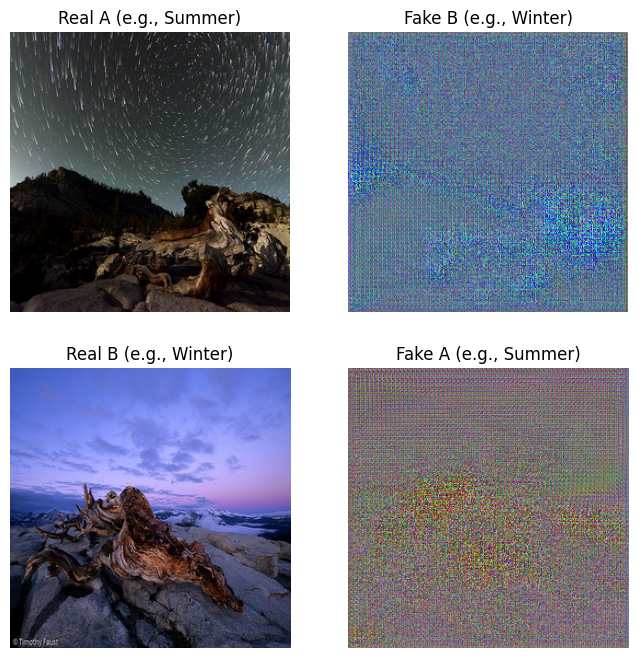

Epoch 1/100:  65%|████████████████████████████████████████████▏                       | 200/308 [00:38<00:20,  5.25it/s]

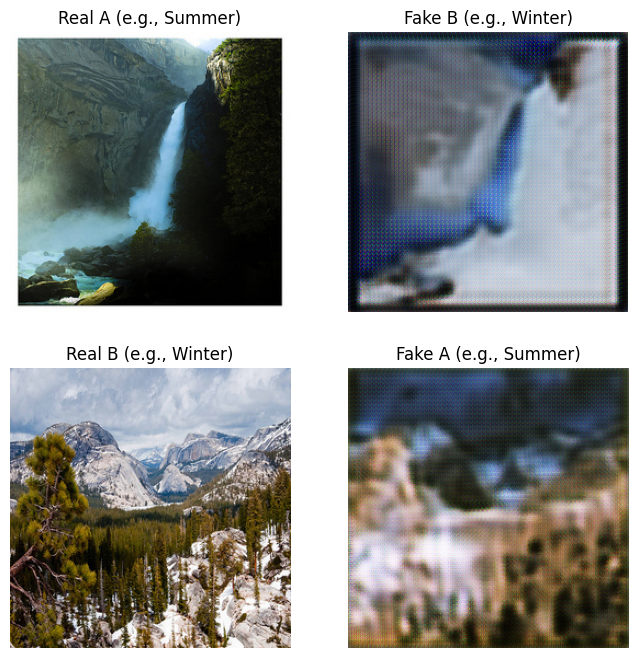

Epoch 1/100: 100%|████████████████████████████████████████████████████████████████████| 308/308 [00:58<00:00,  5.25it/s]


Epoch [0/100], Batch [307], Loss G: 7.817951679229736, Loss D_A: 0.30479180812835693, Loss D_B: 0.44240057468414307


Epoch 2/100:   0%|                                                                              | 0/308 [00:00<?, ?it/s]

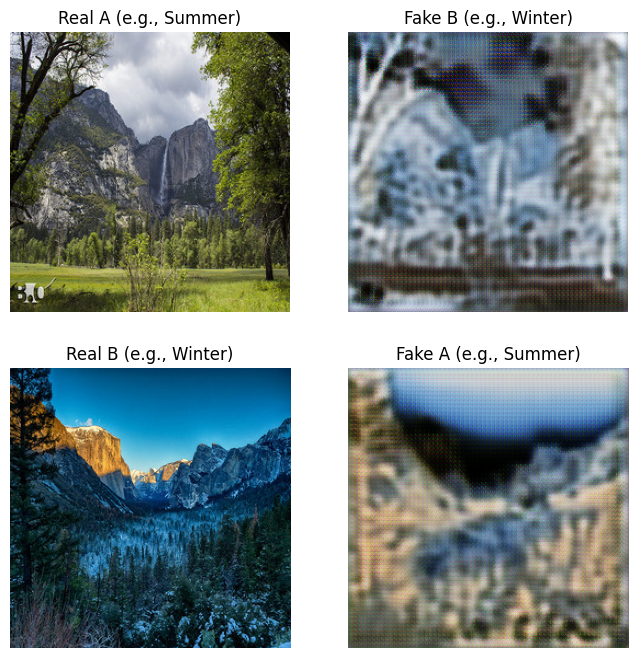

Epoch 2/100:  65%|████████████████████████████████████████████▏                       | 200/308 [00:37<00:19,  5.41it/s]

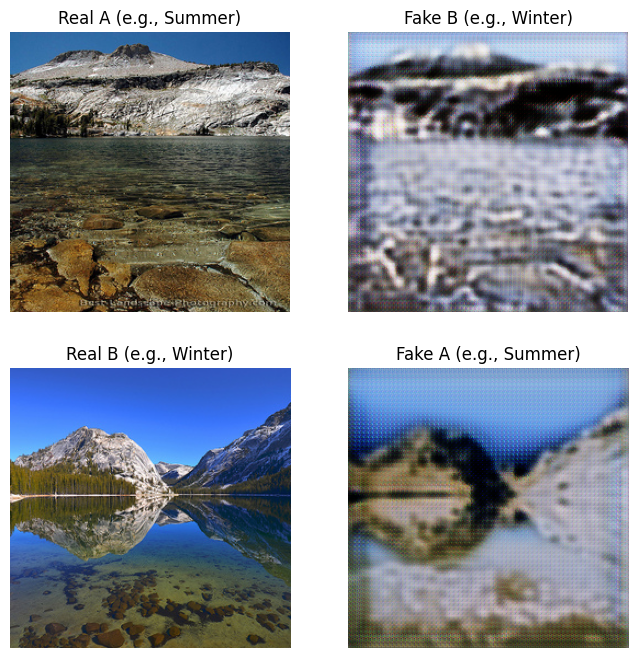

Epoch 2/100: 100%|████████████████████████████████████████████████████████████████████| 308/308 [00:57<00:00,  5.37it/s]


Epoch [1/100], Batch [307], Loss G: 8.384596824645996, Loss D_A: 0.4361824691295624, Loss D_B: 0.28695154190063477


Epoch 3/100:   0%|                                                                              | 0/308 [00:00<?, ?it/s]

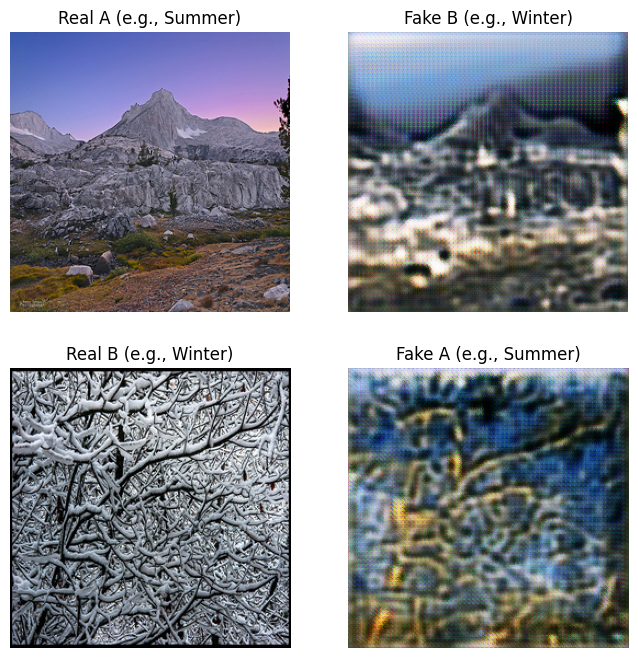

Epoch 3/100:  65%|████████████████████████████████████████████▏                       | 200/308 [00:37<00:20,  5.34it/s]

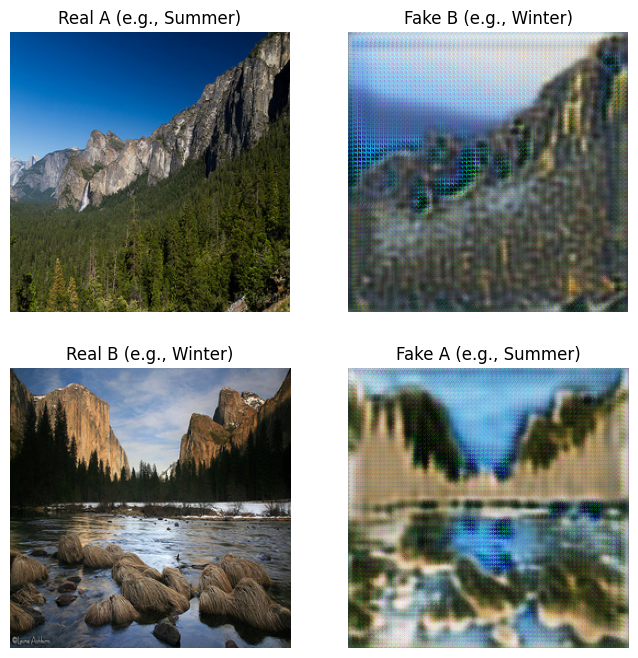

Epoch 3/100: 100%|████████████████████████████████████████████████████████████████████| 308/308 [00:57<00:00,  5.35it/s]


Epoch [2/100], Batch [307], Loss G: 4.999935626983643, Loss D_A: 0.5158061981201172, Loss D_B: 0.44155746698379517


Epoch 4/100:   0%|                                                                              | 0/308 [00:00<?, ?it/s]

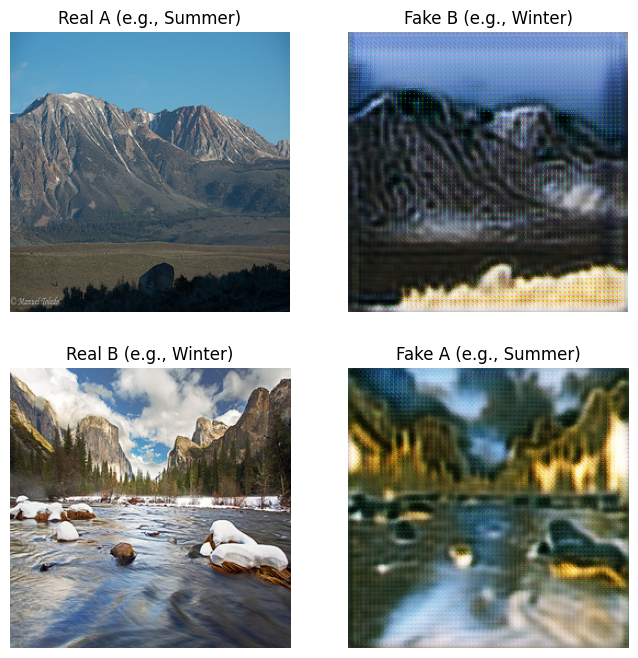

Epoch 4/100:  65%|████████████████████████████████████████████▏                       | 200/308 [00:37<00:20,  5.35it/s]

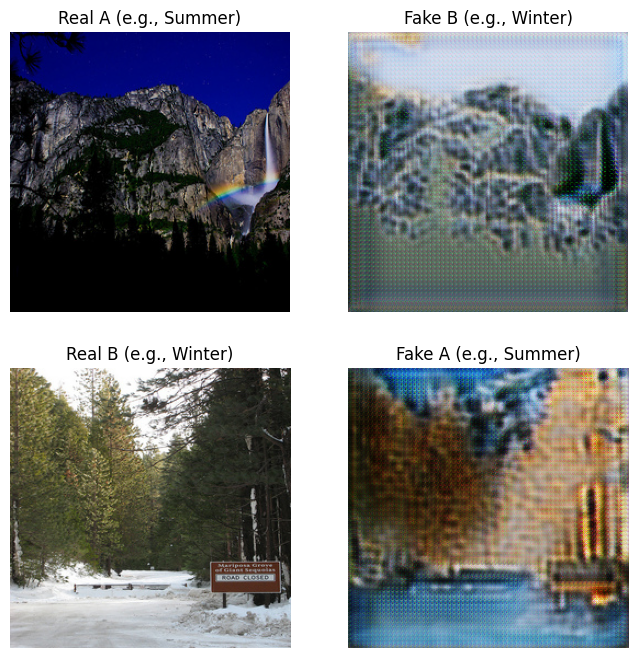

Epoch 4/100: 100%|████████████████████████████████████████████████████████████████████| 308/308 [00:57<00:00,  5.34it/s]


Epoch [3/100], Batch [307], Loss G: 4.599365711212158, Loss D_A: 0.21980080008506775, Loss D_B: 0.2722885012626648


Epoch 5/100:   0%|                                                                              | 0/308 [00:00<?, ?it/s]

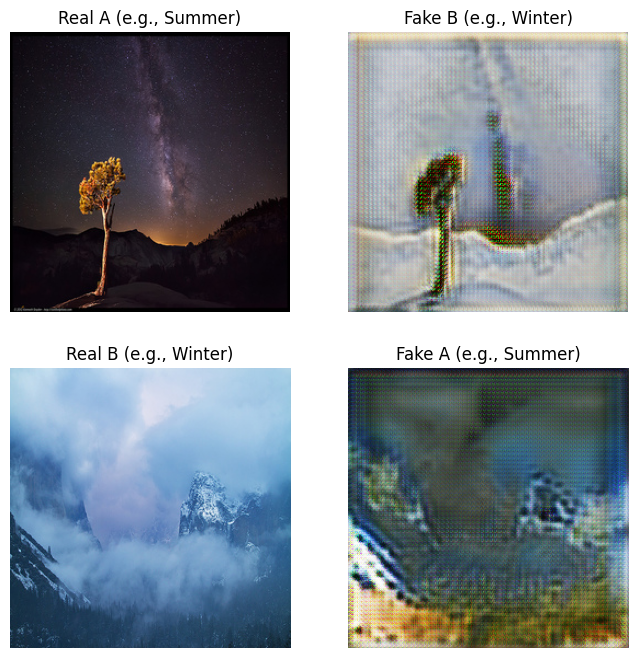

Epoch 5/100:  65%|████████████████████████████████████████████▏                       | 200/308 [00:37<00:20,  5.31it/s]

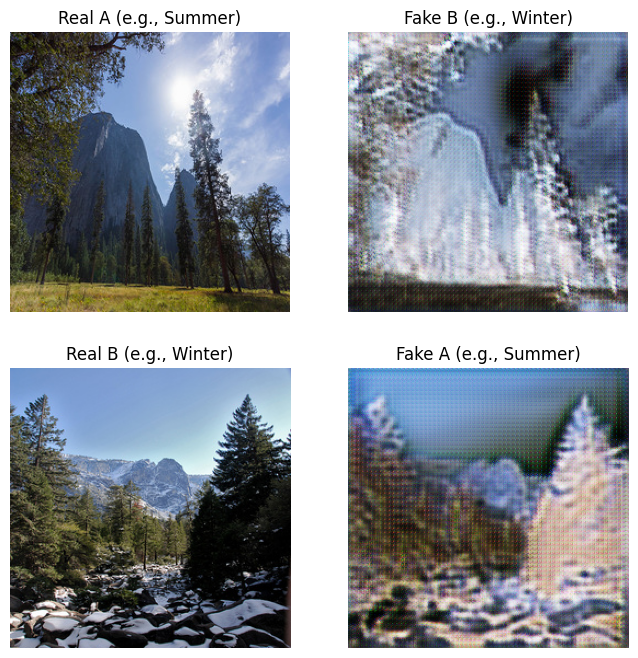

Epoch 5/100: 100%|████████████████████████████████████████████████████████████████████| 308/308 [00:57<00:00,  5.35it/s]


Epoch [4/100], Batch [307], Loss G: 5.236947536468506, Loss D_A: 0.22845244407653809, Loss D_B: 0.2582469880580902


Epoch 6/100:   0%|                                                                              | 0/308 [00:00<?, ?it/s]

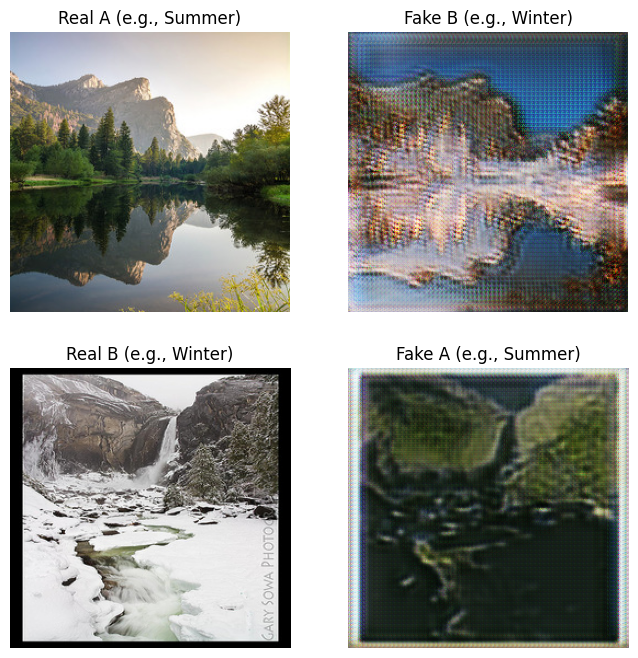

Epoch 6/100:  65%|████████████████████████████████████████████▏                       | 200/308 [00:37<00:20,  5.26it/s]

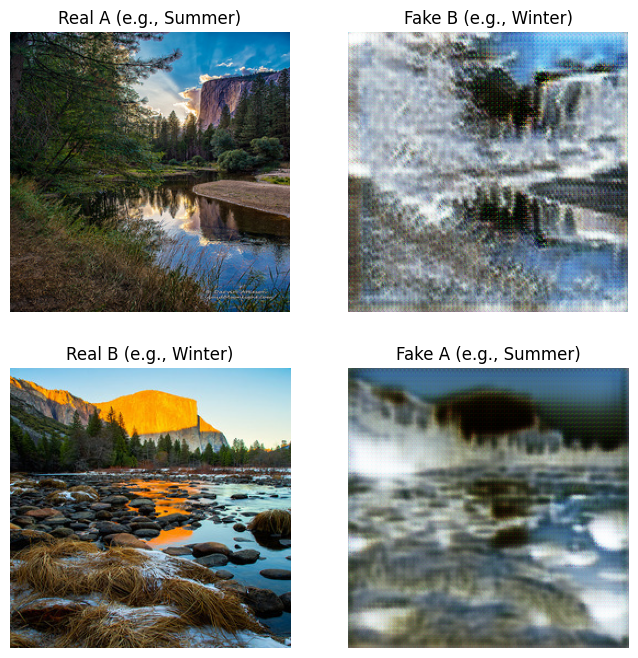

Epoch 6/100: 100%|████████████████████████████████████████████████████████████████████| 308/308 [00:57<00:00,  5.35it/s]


Epoch [5/100], Batch [307], Loss G: 7.999124526977539, Loss D_A: 0.47184282541275024, Loss D_B: 0.2175133377313614


Epoch 7/100:   0%|                                                                              | 0/308 [00:00<?, ?it/s]

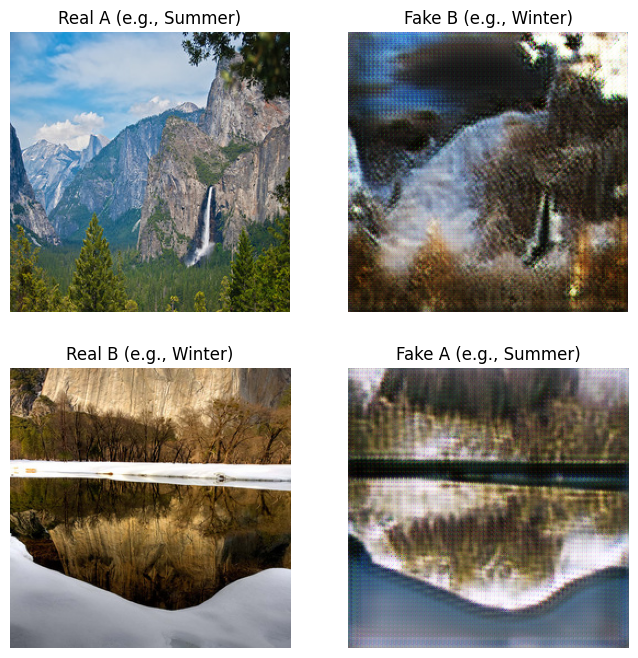

Epoch 7/100:  65%|████████████████████████████████████████████▏                       | 200/308 [00:37<00:19,  5.63it/s]

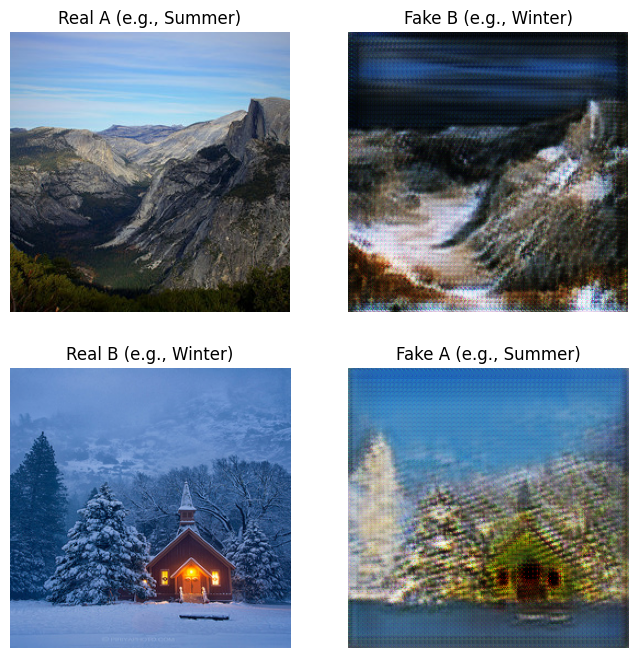

Epoch 7/100: 100%|████████████████████████████████████████████████████████████████████| 308/308 [00:57<00:00,  5.34it/s]


Epoch [6/100], Batch [307], Loss G: 4.2124104499816895, Loss D_A: 0.27413588762283325, Loss D_B: 0.29829567670822144


Epoch 8/100:   0%|                                                                              | 0/308 [00:00<?, ?it/s]

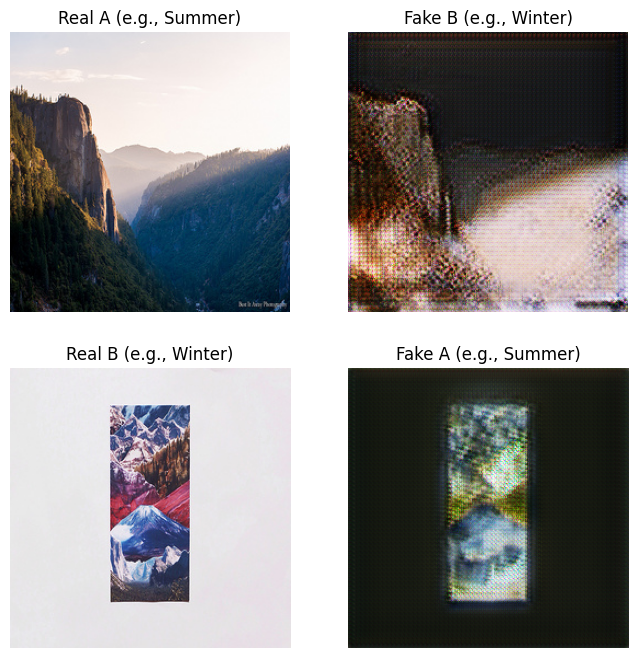

Epoch 8/100:  65%|████████████████████████████████████████████▏                       | 200/308 [00:37<00:19,  5.52it/s]

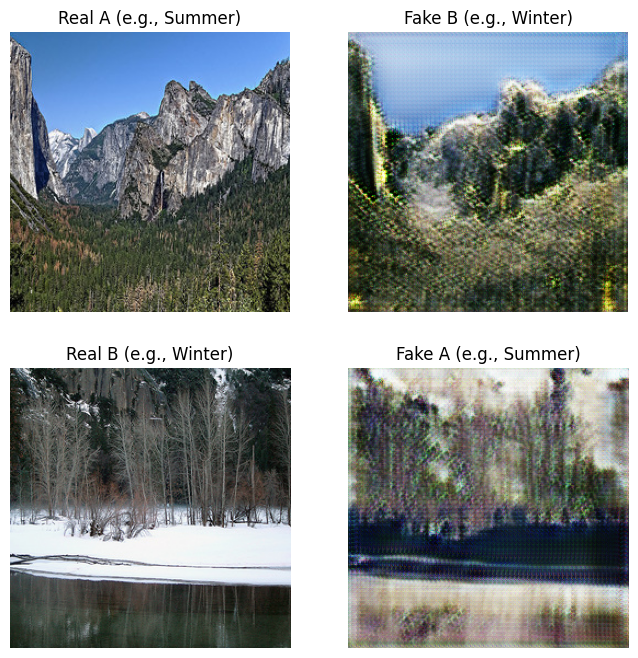

Epoch 8/100: 100%|████████████████████████████████████████████████████████████████████| 308/308 [00:57<00:00,  5.32it/s]


Epoch [7/100], Batch [307], Loss G: 3.6663031578063965, Loss D_A: 0.36390239000320435, Loss D_B: 0.5445640087127686


Epoch 9/100:   0%|                                                                              | 0/308 [00:00<?, ?it/s]

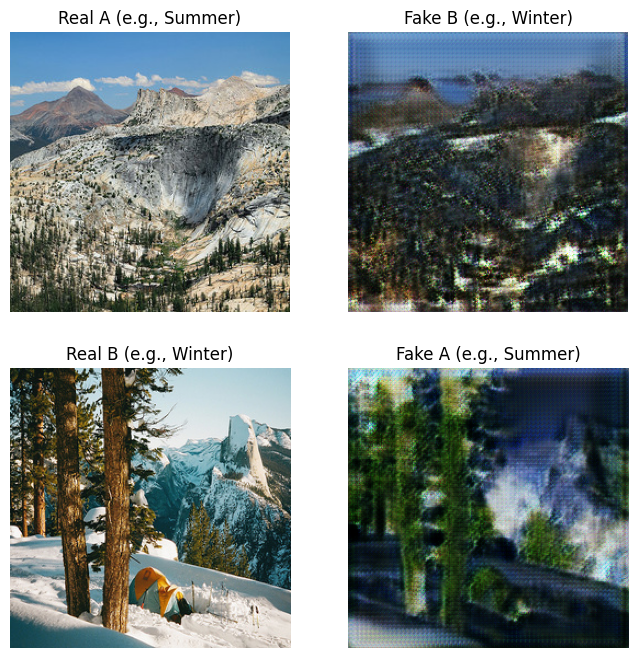

Epoch 9/100:  65%|████████████████████████████████████████████▏                       | 200/308 [00:37<00:20,  5.39it/s]

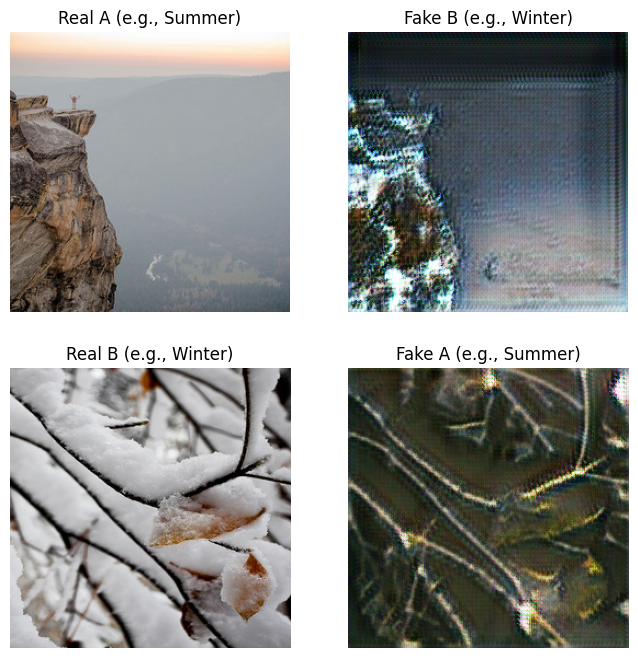

Epoch 9/100: 100%|████████████████████████████████████████████████████████████████████| 308/308 [00:58<00:00,  5.30it/s]


Epoch [8/100], Batch [307], Loss G: 6.666525840759277, Loss D_A: 0.6602219939231873, Loss D_B: 0.5413542985916138


Epoch 10/100:   0%|                                                                             | 0/308 [00:00<?, ?it/s]

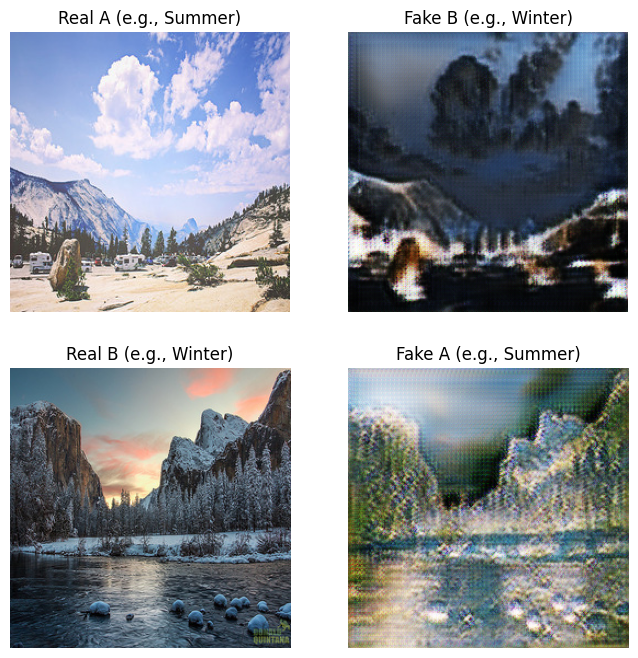

Epoch 10/100:  65%|███████████████████████████████████████████▌                       | 200/308 [00:37<00:20,  5.25it/s]

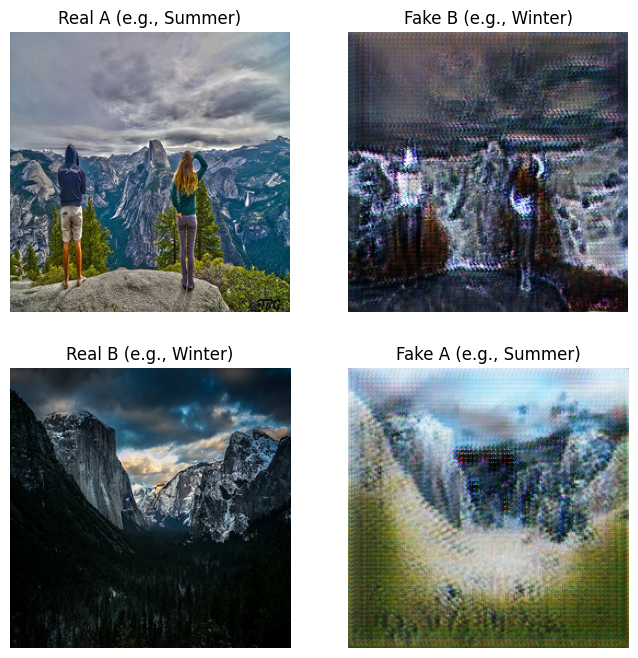

Epoch 10/100: 100%|███████████████████████████████████████████████████████████████████| 308/308 [00:58<00:00,  5.28it/s]


Epoch [9/100], Batch [307], Loss G: 3.7770042419433594, Loss D_A: 0.347835898399353, Loss D_B: 0.24480271339416504


Epoch 11/100:   0%|                                                                             | 0/308 [00:00<?, ?it/s]

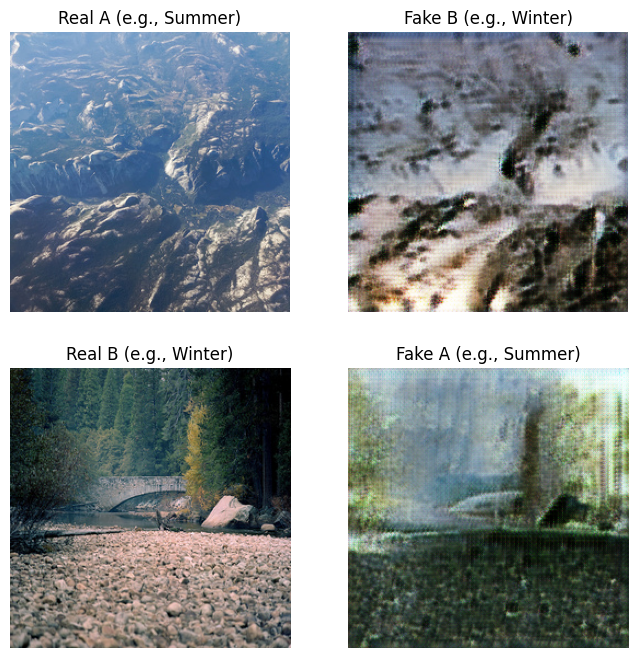

Epoch 11/100:  65%|███████████████████████████████████████████▌                       | 200/308 [00:37<00:20,  5.37it/s]

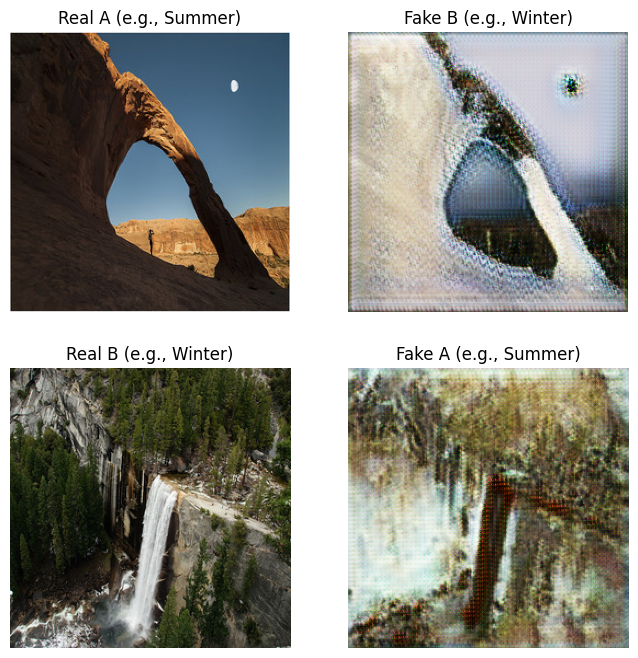

Epoch 11/100: 100%|███████████████████████████████████████████████████████████████████| 308/308 [00:58<00:00,  5.28it/s]


Epoch [10/100], Batch [307], Loss G: 3.9483799934387207, Loss D_A: 0.4478198289871216, Loss D_B: 0.5488208532333374


Epoch 12/100:   0%|                                                                             | 0/308 [00:00<?, ?it/s]

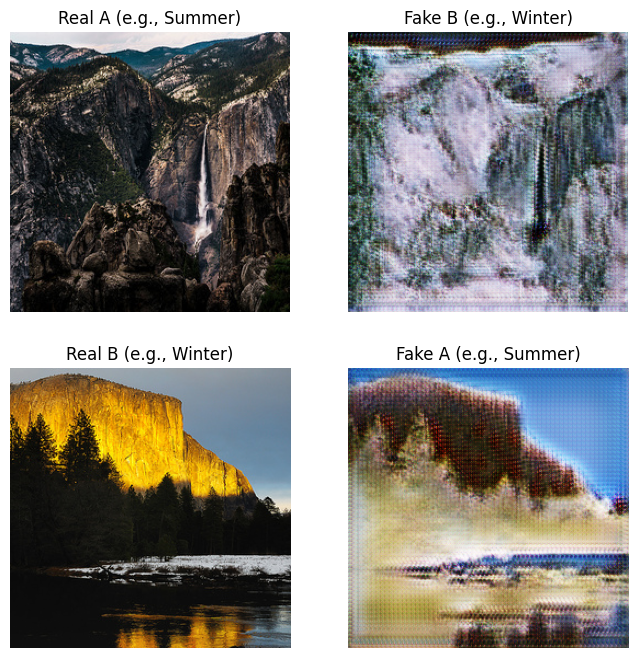

Epoch 12/100:  65%|███████████████████████████████████████████▎                       | 199/308 [00:37<00:20,  5.26it/s]


KeyboardInterrupt: 

In [10]:
generator_A2B = GeneratorResNet().to(device)
generator_B2A = GeneratorResNet().to(device)
discriminator_A = Discriminator().to(device)
discriminator_B = Discriminator().to(device)

criterion_GAN = nn.MSELoss()
criterion_cycle = nn.L1Loss()

optimizer_G = optim.Adam(list(generator_A2B.parameters()) + list(generator_B2A.parameters()), lr=0.0001, betas=(0.5, 0.999))
optimizer_D_A = optim.Adam(discriminator_A.parameters(), lr=0.00005, betas=(0.5, 0.999))
optimizer_D_B = optim.Adam(discriminator_B.parameters(), lr=0.00005, betas=(0.5, 0.999))

num_epochs = 100

for epoch in range(num_epochs):
    progress_bar = tqdm(enumerate(dataloader), total=len(dataloader), desc=f"Epoch {epoch+1}/{num_epochs}")
    for i, batch in progress_bar :
        real_A = batch['A'][0].unsqueeze(0).to(device)  
        real_B = batch['B'][0].unsqueeze(0).to(device)  

        fake_B = generator_A2B(real_A)
        fake_A = generator_B2A(real_B)

        rec_A = generator_B2A(fake_B)
        rec_B = generator_A2B(fake_A)

        loss_GAN_A2B = criterion_GAN(discriminator_B(fake_B), torch.ones_like(discriminator_B(fake_B)))
        loss_GAN_B2A = criterion_GAN(discriminator_A(fake_A), torch.ones_like(discriminator_A(fake_A)))

        loss_cycle_A = criterion_cycle(rec_A, real_A)
        loss_cycle_B = criterion_cycle(rec_B, real_B)

        loss_G = loss_GAN_A2B + loss_GAN_B2A + 10.0 * (loss_cycle_A + loss_cycle_B)

        optimizer_G.zero_grad()
        loss_G.backward()
        optimizer_G.step()

        loss_D_A = criterion_GAN(discriminator_A(real_A), torch.ones_like(discriminator_A(real_A))) + \
                   criterion_GAN(discriminator_A(fake_A.detach()), torch.zeros_like(discriminator_A(fake_A)))
        optimizer_D_A.zero_grad()
        loss_D_A.backward()
        optimizer_D_A.step()

 
        loss_D_B = criterion_GAN(discriminator_B(real_B), torch.ones_like(discriminator_B(real_B))) + \
                   criterion_GAN(discriminator_B(fake_B.detach()), torch.zeros_like(discriminator_B(fake_B)))
        optimizer_D_B.zero_grad()
        loss_D_B.backward()
        optimizer_D_B.step()

        if i % 200 == 0:
            # Visualize the results
            show_training_images(real_A[0], fake_B[0], real_B[0], fake_A[0])

    print(f"Epoch [{epoch}/{num_epochs}], Batch [{i}], Loss G: {loss_G.item()}, Loss D_A: {loss_D_A.item()}, Loss D_B: {loss_D_B.item()}")